In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import h5py
import os

/home/apk/anaconda2/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
efile=['ME_2_2018.11.05_11.23.57.hdf5','ME_3_2018.11.05_11.26.37.hdf5','ME_4_2018.11.05_11.29.12.hdf5',
       'ME_8_2018.11.05_11.32.30.hdf5','ME_9_2018.11.05_11.34.38.hdf5','ME_10_2018.11.05_11.36.35.hdf5'
       ,'ME_11_2018.11.05_11.38.37.hdf5','ME_12_2018.11.05_11.40.54.hdf5','ME_13_R2018.11.05_11.42.46.hdf5',
       'ME_14_a_R2018.11.05_11.44.17.hdf5','ME_14_b_R2018.11.05_11.45.04.hdf5','ME_14_c_R2018.11.05_11.45.50.hdf5',
       'ME_14_d2018.11.05_11.47.06.hdf5','ME_15_2018.11.05_11.49.06.hdf5',
       'ME_16_2018.11.05_11.50.17.hdf5','ME_17_2018.11.05_11.21.28.hdf5','MI_2_2018.11.05_11.22.46.hdf5',
       'MI_3_2018.11.05_11.25.10.hdf5','MI_4_2018.11.05_11.27.48.hdf5','MI_8_2018.11.05_11.30.26.hdf5',
       'MI_9_2018.11.05_11.33.32.hdf5','MI_10_2018.11.05_11.35.52.hdf5','MI_11_2018.11.05_11.37.52.hdf5',
       'MI_12_2018.11.05_11.40.03.hdf5','MI_13_2018.11.05_11.41.54.hdf5','MI_15_2018.11.05_11.47.57.hdf5']
#,'ME_14_d_R2018.11.05_11.46.35.hdf5'

In [3]:
for f in efile:
    eeg=h5py.File(f,mode='r')
    print f
    sampletime = np.array(eeg['AsynchronData']["Time"])
    
    sampletime1=np.delete(sampletime, len(sampletime)-1)
    sampletime1=np.delete(sampletime1, 0)
    if len(sampletime)==1:
        sampletime1=sampletime
    if sampletime1[0]/256.0 <=3.0:
        print 'ooh'
        print sampletime1[0]/256.0
    #print (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0
    if (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0 <6.0:
        print 'noooo'
        print (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0

ME_2_2018.11.05_11.23.57.hdf5
ooh
2.54296875
ME_3_2018.11.05_11.26.37.hdf5
ooh
1.99609375
ME_4_2018.11.05_11.29.12.hdf5
ME_8_2018.11.05_11.32.30.hdf5
ME_9_2018.11.05_11.34.38.hdf5
ME_10_2018.11.05_11.36.35.hdf5
ooh
2.953125
ME_11_2018.11.05_11.38.37.hdf5
ME_12_2018.11.05_11.40.54.hdf5
ooh
2.5234375
ME_13_R2018.11.05_11.42.46.hdf5
ME_14_a_R2018.11.05_11.44.17.hdf5
ME_14_b_R2018.11.05_11.45.04.hdf5
noooo
4.8203125
ME_14_c_R2018.11.05_11.45.50.hdf5
ME_14_d2018.11.05_11.47.06.hdf5
noooo
5.03515625
ME_15_2018.11.05_11.49.06.hdf5
ooh
2.0546875
noooo
5.97265625
ME_16_2018.11.05_11.50.17.hdf5
ME_17_2018.11.05_11.21.28.hdf5
MI_2_2018.11.05_11.22.46.hdf5
MI_3_2018.11.05_11.25.10.hdf5
MI_4_2018.11.05_11.27.48.hdf5
MI_8_2018.11.05_11.30.26.hdf5
MI_9_2018.11.05_11.33.32.hdf5
MI_10_2018.11.05_11.35.52.hdf5
MI_11_2018.11.05_11.37.52.hdf5
ooh
2.97265625
MI_12_2018.11.05_11.40.03.hdf5
MI_13_2018.11.05_11.41.54.hdf5
noooo
4.1953125
MI_15_2018.11.05_11.47.57.hdf5


In [4]:
import scipy.signal as signal
def butter_bandpass(lowcut, fs, order):
    nyq = 0.5 * fs
    low = lowcut / nyq
    
    b, a = signal.butter(order, low, btype='low')
    return b, a

In [5]:
plt.rcParams["figure.figsize"] = [25,16]
path='id6Day30-20190503T212316Z-001'

/home/apk/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


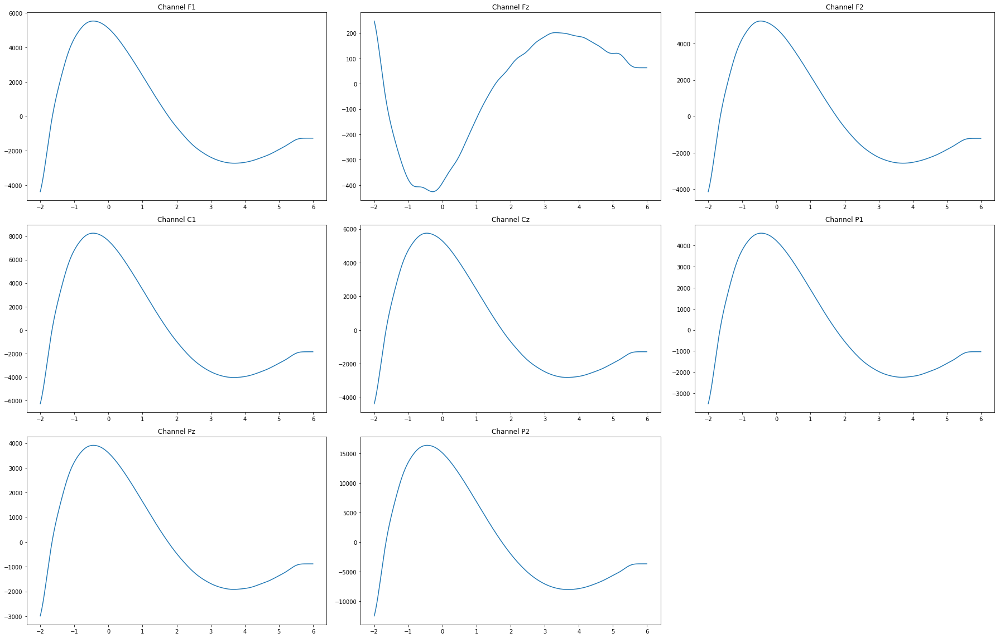

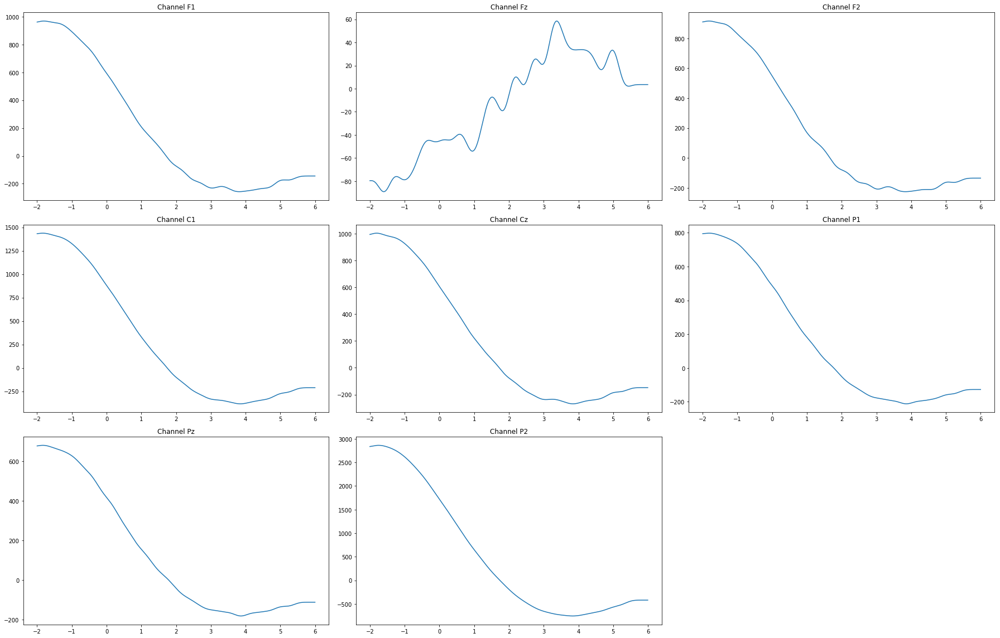

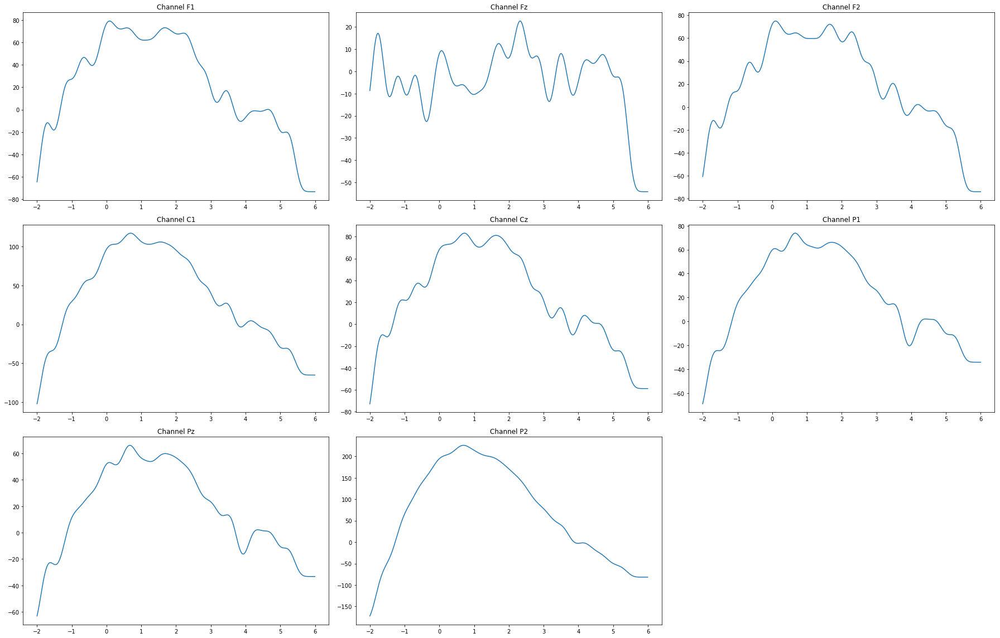

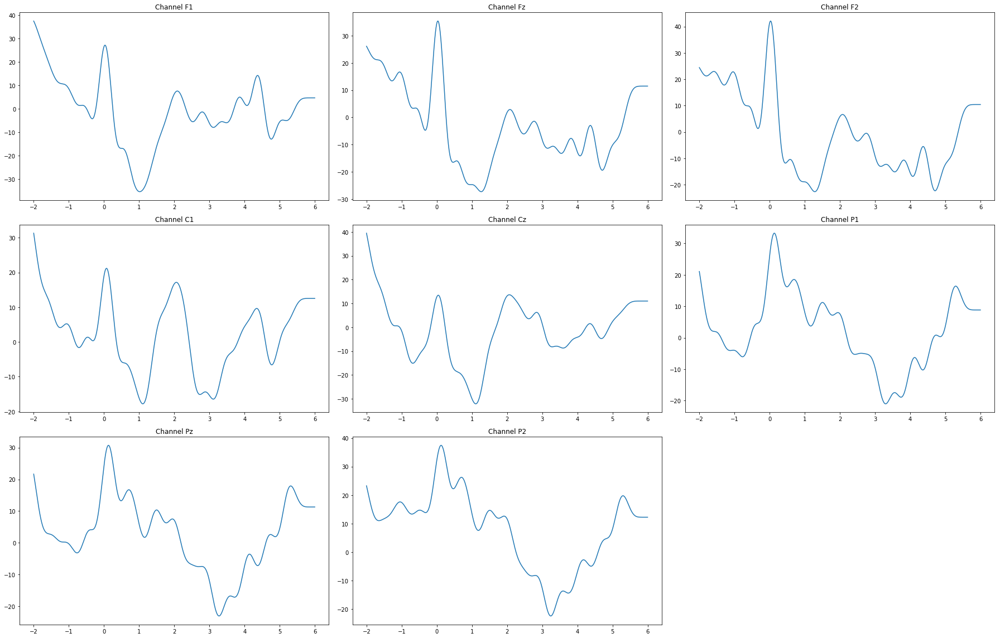

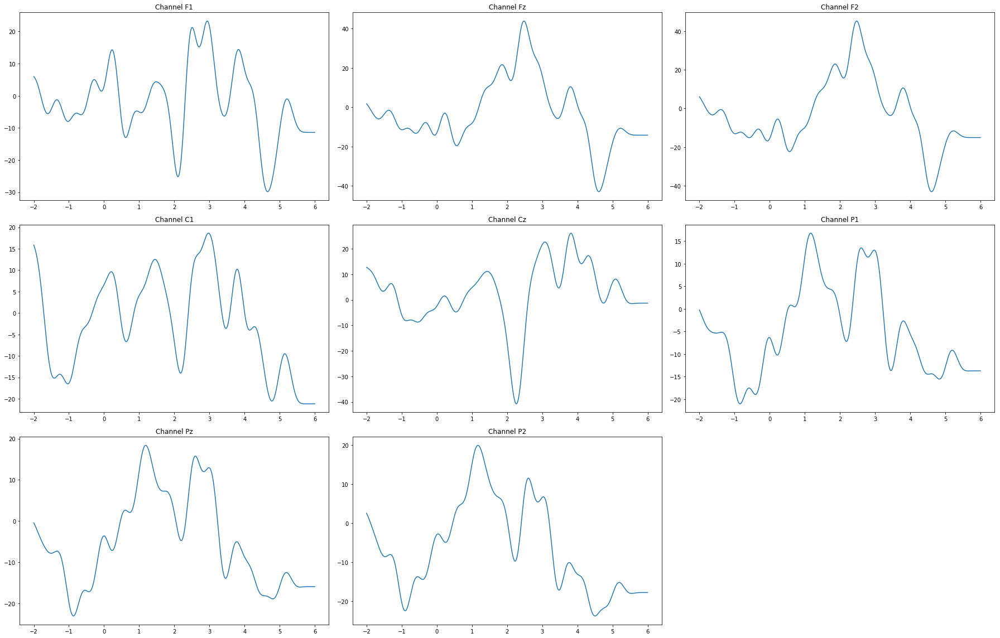

...

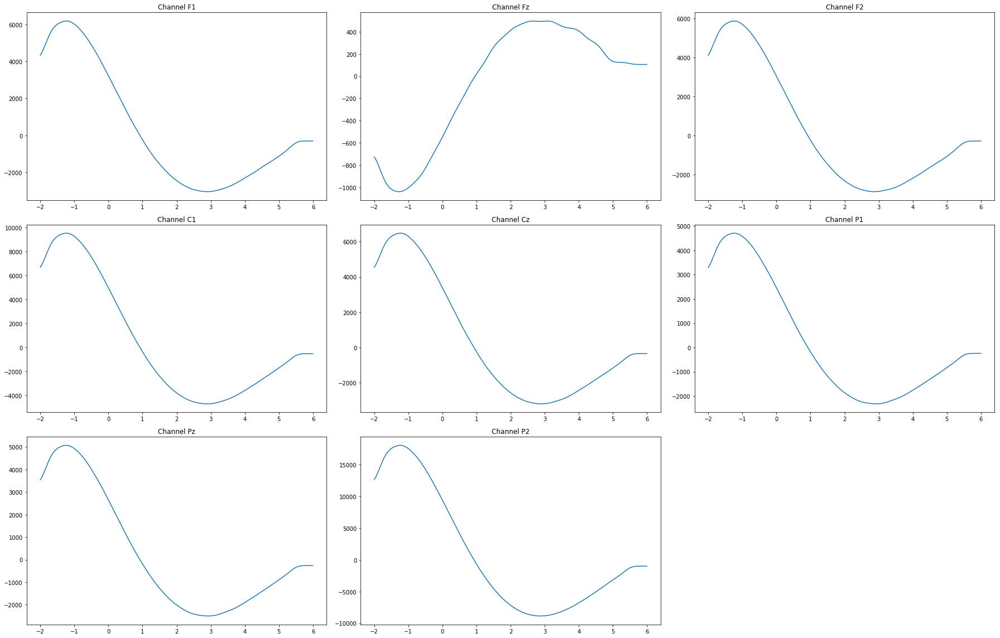

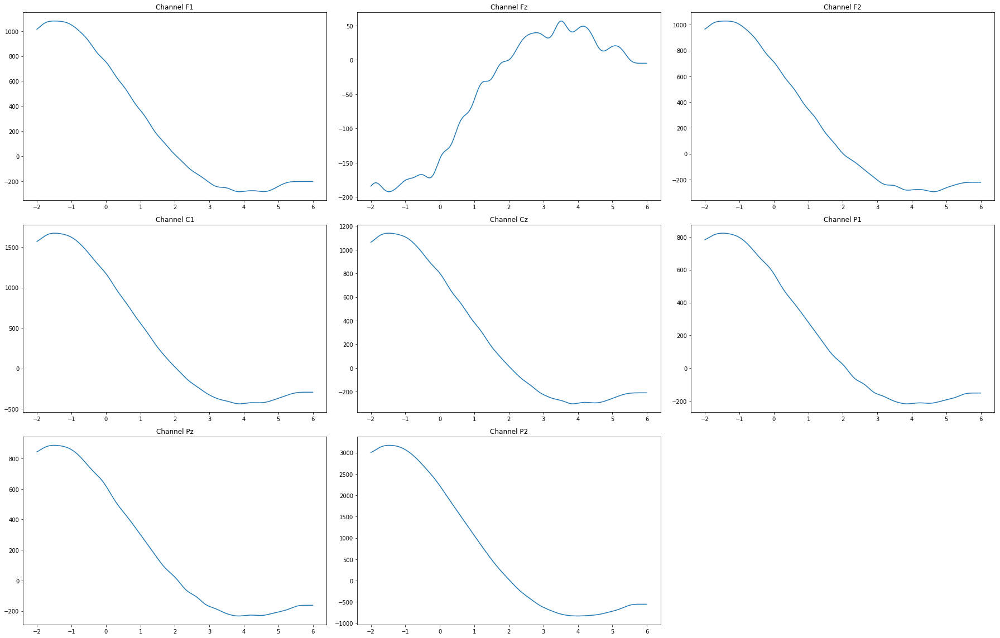

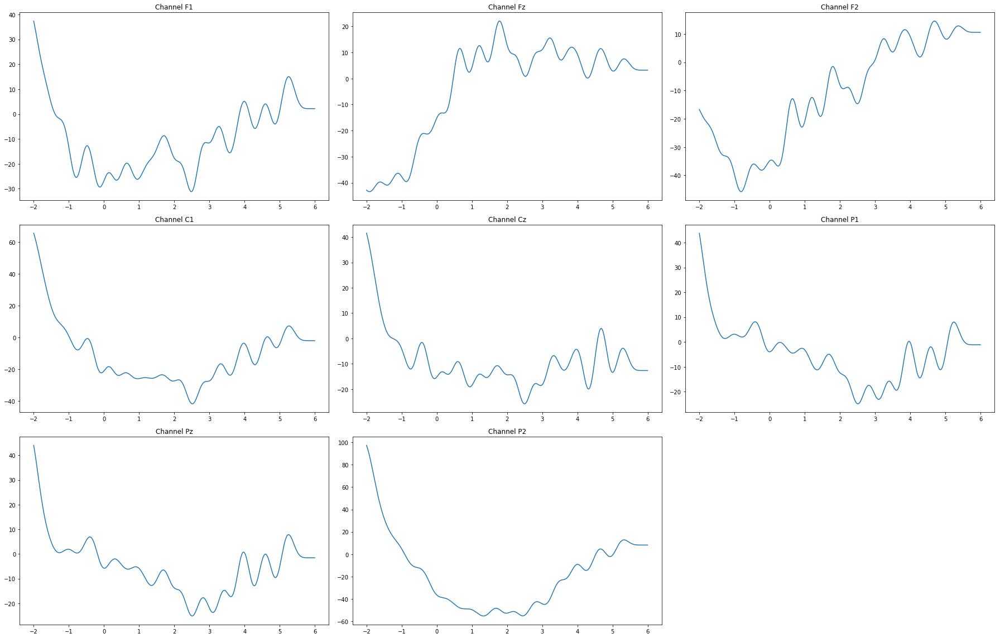

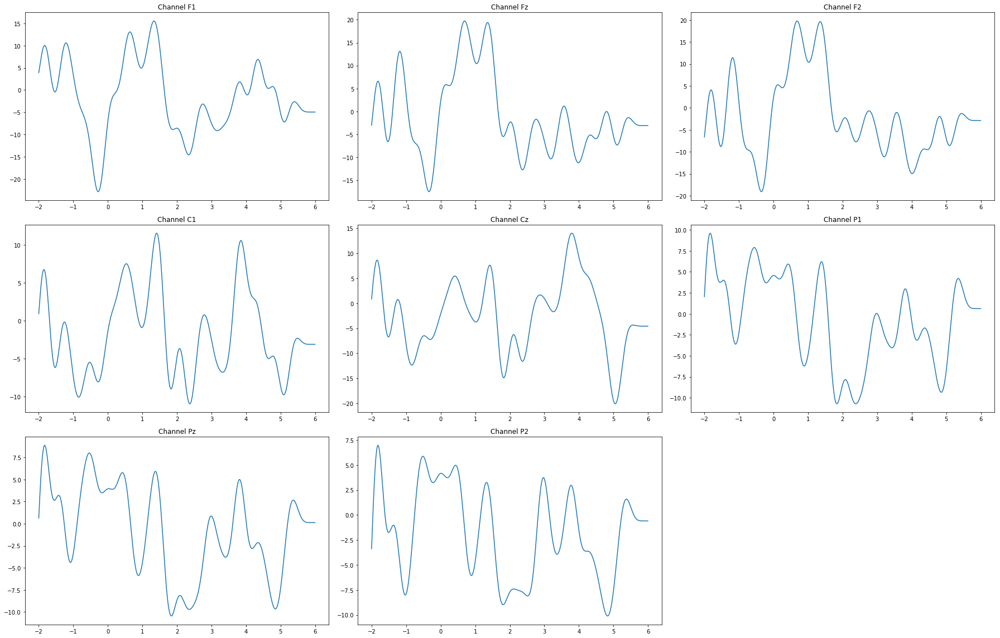

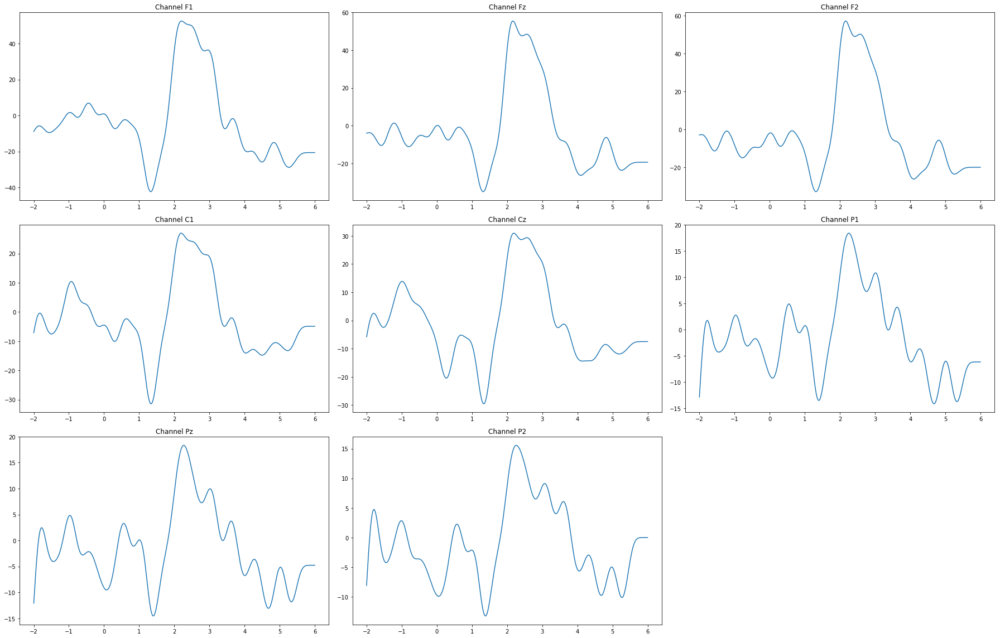

In [7]:
for f in efile:
    m=6.0
    n=2.0
    eeg=h5py.File(f,mode='r')
    sampletime = np.array(eeg['AsynchronData']["Time"])
    sampletime1=np.delete(sampletime, len(sampletime)-1)
    sampletime1=np.delete(sampletime1, 0)
    
    if (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0 <6.0 and (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0>=5.0:
        #sampletime1=np.delete(sampletime1, len(sampletime1)-1)
        m=5.0
        
    if (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0 <5.0:
        sampletime1=np.delete(sampletime1, len(sampletime1)-1)
    
    if sampletime1[0]/256.0 <=2.0:
        sampletime1=np.delete(sampletime1, 0)
    samples=np.array(eeg['RawData']['Samples'])
    samples=samples.T
    f1=samples[10]
    fz=samples[11]
    f2=samples[12]
    c1=samples[28]
    cz=samples[29]
    p1=samples[46]
    pz=samples[47]
    p2=samples[48]
    channels=[]
    channels.append(f1)
    channels.append(fz)
    channels.append(f2)
    channels.append(c1)
    channels.append(cz)
    channels.append(p1)
    channels.append(pz)
    channels.append(p2)
    fchannels=[]
    for i in range(0, len(channels)):
        c=[]
        for  j in sampletime1:
            c.append(channels[i][j-2*256:j+int(m)*256])
        fchannels.append(c)
        
    filtered=fchannels
    freq=2
    fs=256
    order=8
    for i in range (0, len(fchannels)):
        for j in range(0, len(fchannels[i])):
            b, a= butter_bandpass(freq, fs, order)
            x=(signal.filtfilt(b, a, fchannels[i][j], padlen=0))
            #x=x*1.0/np.max(x)
            filtered[i][j]=x
            
    
    
    name=f[0:5]
    for j in range(0, len(filtered[0])):
        activity=f+'_'+str(j+1)
        fig = plt.figure()
        plot=fig.add_subplot(3,3,1)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[0][j])
        plt.title('Channel F1')

        plot=fig.add_subplot(3,3,2)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[1][j])
        plt.title('Channel Fz')

        plot=fig.add_subplot(3,3,3)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[2][j])
        plt.title('Channel F2')

        plot=fig.add_subplot(3,3,4)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[3][j])
        plt.title('Channel C1')


        plot=fig.add_subplot(3,3,5)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[4][j])
        plt.title('Channel Cz')

        plot=fig.add_subplot(3,3,6)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[5][j])
        plt.title('Channel P1')

        plot=fig.add_subplot(3,3,7)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[6][j])
        plt.title('Channel Pz')

        plot=fig.add_subplot(3,3,8)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[7][j])
        plt.title('Channel P2')

        plt.tight_layout()
        plt.savefig(path+'/'+activity+'.png')

In [8]:
print len(efile)

26
